In [3]:
import pandas as pd
import numpy as np
import seaborn as sns 
import matplotlib.pyplot as plt
from matplotlib import *
import sys
import sklearn
from sklearn.decomposition import TruncatedSVD
from sklearn.metrics import accuracy_score

# 1. EDA
### Reading in the Datasets

In [5]:
imdb = pd.read_csv("imdb-videogames.csv")

steam = pd.read_csv("steam-200k.csv", header=None)

In [18]:
display(imdb.iloc[:5])
display(steam.iloc[:5])

,Unnamed: 0,name,url,year,certificate,rating,votes,plot,Action,Adventure,Comedy,Crime,Family,Fantasy,Mystery,Sci-Fi,Thriller
0,0,Spider-Man,https://www.imdb.com/title/tt5807780/?ref_=adv...,2018.0,T,9.2,"20,759","When a new villain threatens New York City, Pe...",True,True,False,False,False,True,False,False,False
1,1,Red Dead Redemption II,https://www.imdb.com/title/tt6161168/?ref_=adv...,2018.0,M,9.7,"35,703",Amidst the decline of the Wild West at the tur...,True,True,False,True,False,False,False,False,False
2,2,Grand Theft Auto V,https://www.imdb.com/title/tt2103188/?ref_=adv...,2013.0,M,9.5,"59,986",Three very different criminals team up for a s...,True,False,False,True,False,False,False,False,False
3,3,God of War,https://www.imdb.com/title/tt5838588/?ref_=adv...,2018.0,M,9.6,"26,118","After wiping out the gods of Mount Olympus, Kr...",True,True,False,False,False,False,False,False,False
4,4,Uncharted 4: A Thief's End,https://www.imdb.com/title/tt3334704/?ref_=adv...,2016.0,T,9.5,"28,722",Thrown back into the dangerous underworld he'd...,True,True,False,False,False,False,False,False,False


,0,1,2,3,4
0,151603712,The Elder Scrolls V Skyrim,purchase,1.0,0
1,151603712,The Elder Scrolls V Skyrim,play,273.0,0
2,151603712,Fallout 4,purchase,1.0,0
3,151603712,Fallout 4,play,87.0,0
4,151603712,Spore,purchase,1.0,0


### IMDB Dataset - Initial Cleaning

In [27]:
imdb = imdb.drop(imdb.columns[[0, 2]],axis = 1)

In [36]:
print(f"IMDB Dataset Info:\n{imdb.info()}")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20803 entries, 0 to 20802
Data columns (total 15 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   name         20803 non-null  object 
 1   year         20536 non-null  float64
 2   certificate  7903 non-null   object 
 3   rating       11600 non-null  float64
 4   votes        11600 non-null  object 
 5   plot         20803 non-null  object 
 6   Action       20803 non-null  bool   
 7   Adventure    20803 non-null  bool   
 8   Comedy       20803 non-null  bool   
 9   Crime        20803 non-null  bool   
 10  Family       20803 non-null  bool   
 11  Fantasy      20803 non-null  bool   
 12  Mystery      20803 non-null  bool   
 13  Sci-Fi       20803 non-null  bool   
 14  Thriller     20803 non-null  bool   
dtypes: bool(9), float64(2), object(4)
memory usage: 1.1+ MB
IMDB Dataset Info:
None


In [37]:
print(f"Number of Unique values in IMDB Dataset:\n{imdb.nunique()}")

Number of Unique values in IMDB Dataset:
name           19714
year              61
certificate       21
rating            86
votes           1905
plot           11276
Action             2
Adventure          2
Comedy             2
Crime              2
Family             2
Fantasy            2
Mystery            2
Sci-Fi             2
Thriller           2
dtype: int64


In [38]:
print(f"IMDB Summary Statistics:\n{imdb.describe()}")

IMDB Summary Statistics:
               year        rating
count  20536.000000  11600.000000
mean    2005.568611      7.047526
std       11.846028      1.235204
min     1952.000000      1.000000
25%     1997.000000      6.400000
50%     2008.000000      7.200000
75%     2016.000000      7.900000
max     2027.000000      9.700000


In [10]:
display(steam.iloc[:5])
print(steam.info())

,0,1,2,3,4
0,151603712,The Elder Scrolls V Skyrim,purchase,1.0,0
1,151603712,The Elder Scrolls V Skyrim,play,273.0,0
2,151603712,Fallout 4,purchase,1.0,0
3,151603712,Fallout 4,play,87.0,0
4,151603712,Spore,purchase,1.0,0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Data columns (total 5 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   0       200000 non-null  int64  
 1   1       200000 non-null  object 
 2   2       200000 non-null  object 
 3   3       200000 non-null  float64
 4   4       200000 non-null  int64  
dtypes: float64(1), int64(2), object(2)
memory usage: 7.6+ MB
None


### Steam Dataset - Initial Cleaning

In [4]:
# gets rid of all the rows with purchase, as they don't provide any additional information
steam = steam[steam.iloc[:, -3].str.contains("purchase") == False]

steam = steam.drop(steam.columns[[2, 4]], axis = 1)
steam.columns = ["Player", "Game", "Playtime"]

display(imdb.iloc[:5])
display(steam.iloc[:5])

,name,Action,Adventure,Comedy,Crime,Family,Fantasy,Mystery,Sci-Fi,Thriller
0,Spider-Man,True,True,False,False,False,True,False,False,False
1,Red Dead Redemption II,True,True,False,True,False,False,False,False,False
2,Grand Theft Auto V,True,False,False,True,False,False,False,False,False
3,God of War,True,True,False,False,False,False,False,False,False
4,Uncharted 4: A Thief's End,True,True,False,False,False,False,False,False,False


,Player,Game,Playtime
1,151603712,The Elder Scrolls V Skyrim,273.0
3,151603712,Fallout 4,87.0
5,151603712,Spore,14.9
7,151603712,Fallout New Vegas,12.1
9,151603712,Left 4 Dead 2,8.9


In [16]:
print(f"IMDB Summary Statistics:\n {imdb.describe()}")

IMDB Summary Statistics:
               name Action Adventure Comedy  Crime Family Fantasy Mystery  \
count        20803  20803     20803  20803  20803  20803   20803   20803   
unique       19714      2         2      2      2      2       2       2   
top     Spider-Man   True     False  False  False  False   False   False   
freq             9  11930     10469  19020  19908  17928   16453   19618   

       Sci-Fi Thriller  
count   20803    20803  
unique      2        2  
top     False    False  
freq    17213    20280  


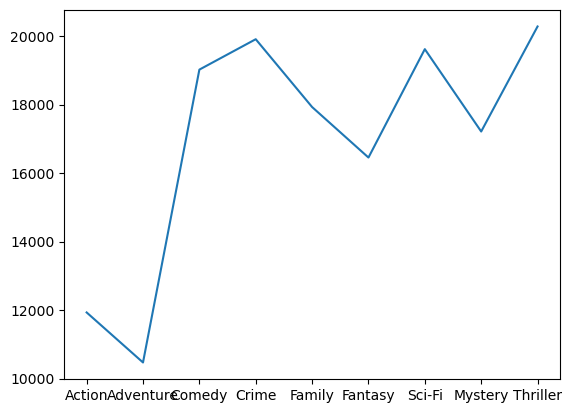

In [17]:
import matplotlib as plt
from matplotlib import pyplot as plt

freq_imdb = pd.DataFrame({'Genre': ['Action', 'Adventure', 'Comedy', 'Crime', 'Family', 'Fantasy', 'Sci-Fi', 'Mystery', 'Thriller'],
                          'Frequency': [11930, 10469, 19020, 19908, 17928, 16453, 19618, 17213, 20280]})

plt.plot(freq_imdb['Genre'], freq_imdb['Frequency'])
plt.show()

In [18]:
# creating dictionary of games and genres
dict1 = {}
for index, row in imdb.iterrows():
    if row["name"] not in dict1: 
        dict1[row["name"]] = []
        if row["Action"] == True:
            dict1[row["name"]].append("Action")
        if row['Adventure'] == True:
            dict1[row['name']].append("Adventure")
        if row['Comedy'] == True:
            dict1[row['name']].append("Comedy")
        if row['Crime'] == True:
            dict1[row['name']].append("Crime")
        if row['Family'] == True:
            dict1[row['name']].append("Family")
        if row['Fantasy'] == True:
            dict1[row['name']].append("Fantasy")
        if row['Sci-Fi'] == True:
            dict1[row['name']].append("Sci-Fi")
        if row['Mystery'] == True:
            dict1[row['name']].append("Mystery")
        if row['Thriller'] == True:
            dict1[row['name']].append("Thriller")

In [19]:
df2 = pd.DataFrame({'user': steam.iloc[:,0], 'games': steam.iloc[:,1],'hours': steam.iloc[:,2]})
df2 = df2.pivot_table(index='user', columns='games', values='hours')
df3 = df2.reindex(columns = df2.columns.tolist() + ['Action', 'Adventure', 'Comedy', 'Crime', 'Family', 'Fantasy', 'Sci-Fi', 'Mystery', 'Thriller'])
df3 = df3.fillna(0)

In [20]:
#adding in hrs per catergory to df
for index, row in df3.iterrows():    
    for i in range(len(df3.columns)):
        if row[i] > 0:
            if df3.columns[i] in dict1:
                for j in dict1[df3.columns[i]]:
                    row[j] += row[i]

In [21]:
df3.head()

games,007 Legends,0RBITALIS,1... 2... 3... KICK IT! (Drop That Beat Like an Ugly Baby),10 Second Ninja,"10,000,000",100% Orange Juice,1000 Amps,12 Labours of Hercules,12 Labours of Hercules II The Cretan Bull,12 Labours of Hercules III Girl Power,...,theHunter Primal,Action,Adventure,Comedy,Crime,Family,Fantasy,Sci-Fi,Mystery,Thriller
user,,,,,,,,,,,,,,,,,,,,,
5250,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
76767,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
86540,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
144736,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
181212,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [22]:
df3 = df3.loc[(df3[['Action', "Adventure", "Comedy", "Crime", "Family", "Fantasy", "Sci-Fi", "Mystery", "Thriller"]] != 0).all(axis=1)]
df_games = df3.iloc[:,:-9]
df_genres = df3.iloc[:,-9:]

print("Full Dataframe Summary Statistics")
df3.describe()

Full Dataframe Summary Statistics


games,007 Legends,0RBITALIS,1... 2... 3... KICK IT! (Drop That Beat Like an Ugly Baby),10 Second Ninja,"10,000,000",100% Orange Juice,1000 Amps,12 Labours of Hercules,12 Labours of Hercules II The Cretan Bull,12 Labours of Hercules III Girl Power,...,theHunter Primal,Action,Adventure,Comedy,Crime,Family,Fantasy,Sci-Fi,Mystery,Thriller
count,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
max,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [23]:
import numpy as np
from numpy.linalg import norm
from sklearn.metrics.pairwise import cosine_similarity

def center(row):
    new_row = (row - row.mean()) / (row.max() - row.min())
    return new_row

df_games_std = df_games.apply(center, axis = 1)
df_genres_std = df_genres.apply(center, axis = 1)
df_genres_std
frames = [df_games_std, df_genres_std]
  
df_joined_std = pd.concat([df_games_std, df_genres_std], axis=1, join='inner')
df_joined_std.head()

games,007 Legends,0RBITALIS,1... 2... 3... KICK IT! (Drop That Beat Like an Ugly Baby),10 Second Ninja,"10,000,000",100% Orange Juice,1000 Amps,12 Labours of Hercules,12 Labours of Hercules II The Cretan Bull,12 Labours of Hercules III Girl Power,...,theHunter Primal,Action,Adventure,Comedy,Crime,Family,Fantasy,Sci-Fi,Mystery,Thriller
user,,,,,,,,,,,,,,,,,,,,,


In [24]:
print("Standardized Full Dataframe Summary Statistics")
df_joined_std.describe()

Standardized Full Dataframe Summary Statistics


games,007 Legends,0RBITALIS,1... 2... 3... KICK IT! (Drop That Beat Like an Ugly Baby),10 Second Ninja,"10,000,000",100% Orange Juice,1000 Amps,12 Labours of Hercules,12 Labours of Hercules II The Cretan Bull,12 Labours of Hercules III Girl Power,...,theHunter Primal,Action,Adventure,Comedy,Crime,Family,Fantasy,Sci-Fi,Mystery,Thriller
count,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
max,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [25]:
cosine_sim_matrix = pd.DataFrame(cosine_similarity(df_joined_std), columns = df_joined_std.T.columns)

print(cosine_sim_matrix)

ValueError: Found array with 0 sample(s) (shape=(0, 3609)) while a minimum of 1 is required by check_pairwise_arrays.

In [ ]:
for i in range(len(cosine_sim_matrix.columns)):
    cosine_sim_matrix = cosine_sim_matrix.rename(columns={cosine_sim_matrix.columns[i]: str(i)})

print(cosine_sim_matrix)

user         0         1         2         3         4         5         6  \
0     1.000000  0.183849  0.627253  0.314184  0.291388  0.877352  0.820797   
1     0.183849  1.000000  0.253105  0.168779  0.153763  0.204027  0.133935   
2     0.627253  0.253105  1.000000  0.322433  0.262141  0.567582  0.594975   
3     0.314184  0.168779  0.322433  1.000000  0.619592  0.246267  0.278663   
4     0.291388  0.153763  0.262141  0.619592  1.000000  0.266430  0.269663   
..         ...       ...       ...       ...       ...       ...       ...   
77    0.427375  0.219761  0.323608  0.279313  0.294039  0.482882  0.278118   
78    0.529221  0.185195  0.284789  0.274356  0.235163  0.574833  0.270926   
79    0.660781  0.195238  0.475563  0.241729  0.254982  0.567671  0.586249   
80    0.346271  0.214349  0.383976  0.308483  0.291736  0.330794  0.336328   
81    0.276157  0.166926  0.225844  0.360032  0.224279  0.243657  0.168419   

user         7         8         9  ...        72        73    

In [ ]:
top_three_sim_genres = pd.DataFrame(cosine_sim_matrix.columns.values[np.argsort(-cosine_sim_matrix.values, axis=1)[:, 1:4]], 
                  index=cosine_sim_matrix.index,
                  columns = ['1st Max','2nd Max','3rd Max']).reset_index().drop(['index'], axis = 1)
print(top_three_sim_genres)   

   1st Max 2nd Max 3rd Max
0        5      32       9
1       42       2      47
2       32      47       0
3        4      45      13
4        3      44      40
..     ...     ...     ...
77      29      56      69
78      61      72      65
79       0      35      36
80      12      31      39
81      13      24      46

[82 rows x 3 columns]


In [ ]:
top_three_1 = df_games.iloc[46,:].nlargest(5).index.tolist()
print(top_three_1)

["Sid Meier's Civilization V", 'Sniper Elite 3', 'Team Fortress 2', 'Borderlands', 'PAYDAY 2']


In [ ]:
def cosine_recommender(user, dataframe):
    full_list = []
    for j in range(3):
        i = 1
        top_three = []
        user_top_three = dataframe.iloc[user,:].nlargest(3).index.tolist()
        while len(set(top_three) - set(user_top_three)) < 3:
            top_three = dataframe.iloc[int(top_three_sim_genres.iloc[user, j]), :].nlargest(i).index.tolist()
            i = i + 1
        for game in top_three:
            if game not in (full_list) and game not in (user_top_three):
                full_list.append(game)
    return full_list

print(cosine_recommender(46, df_games))

['XCOM Enemy Unknown', 'Might & Magic Heroes VI', 'The Elder Scrolls V Skyrim', 'Kerbal Space Program', 'Nosgoth', 'Counter-Strike Global Offensive', 'Total War SHOGUN 2', 'Total War ROME II - Emperor Edition']


In [ ]:
X = df3.values.T

In [ ]:
SVD = TruncatedSVD(n_components=12, random_state=17)
result_matrix = SVD.fit_transform(X)
result_matrix.shape

(3609, 12)

In [ ]:
corr_matrix = np.corrcoef(result_matrix)
corr_matrix.shape

c:\Users\eth86\AppData\Local\Programs\Python\Python310\lib\site-packages\numpy\lib\function_base.py:2829: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
c:\Users\eth86\AppData\Local\Programs\Python\Python310\lib\site-packages\numpy\lib\function_base.py:2830: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


(3609, 3609)

In [ ]:
game_names = df3.columns
games_list = list(game_names)

df_svd = pd.DataFrame(index=list(df3.columns.values))

for column in df3:
    game = games_list.index(column)
    corr_game = corr_matrix[game]
    df_svd[column] = corr_game.tolist()

df_svd

C:\Users\eth86\AppData\Local\Temp\ipykernel_18156\3138318869.py:9: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_svd[column] = corr_game.tolist()
C:\Users\eth86\AppData\Local\Temp\ipykernel_18156\3138318869.py:9: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_svd[column] = corr_game.tolist()
C:\Users\eth86\AppData\Local\Temp\ipykernel_18156\3138318869.py:9: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all c

,007 Legends,0RBITALIS,1... 2... 3... KICK IT! (Drop That Beat Like an Ugly Baby),10 Second Ninja,"10,000,000",100% Orange Juice,1000 Amps,12 Labours of Hercules,12 Labours of Hercules II The Cretan Bull,12 Labours of Hercules III Girl Power,...,theHunter Primal,Action,Adventure,Comedy,Crime,Family,Fantasy,Sci-Fi,Mystery,Thriller
007 Legends,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0RBITALIS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1... 2... 3... KICK IT! (Drop That Beat Like an Ugly Baby),NaN,NaN,1.000000,NaN,0.043444,0.124387,NaN,-0.238348,-0.228048,-0.238109,...,0.250982,0.671312,0.525857,0.886352,0.208661,0.265311,0.508689,0.891590,0.406101,0.240402
10 Second Ninja,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"10,000,000",NaN,NaN,0.043444,NaN,1.000000,0.226130,NaN,0.144392,-0.019125,0.105027,...,-0.260901,0.153959,0.172505,0.168644,0.269874,0.247036,0.102203,0.293699,0.181817,-0.049466
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Family,NaN,NaN,0.265311,NaN,0.247036,0.365367,NaN,0.480506,0.420664,0.470281,...,0.359675,0.617208,0.582272,0.406500,0.596093,1.000000,0.423904,0.487538,0.873286,0.781314
Fantasy,NaN,NaN,0.508689,NaN,0.102203,0.060353,NaN,0.007707,-0.059545,-0.008989,...,0.066891,0.937545,0.969286,0.402573,0.307810,0.423904,1.000000,0.434909,0.258470,0.490153
Sci-Fi,NaN,NaN,0.891590,NaN,0.293699,0.221823,NaN,-0.014646,-0.036864,-0.020330,...,0.194839,0.663655,0.542130,0.954793,0.377257,0.487538,0.434909,1.000000,0.625680,0.392064
Mystery,NaN,NaN,0.406101,NaN,0.181817,0.374905,NaN,0.387972,0.352588,0.382941,...,0.461038,0.505967,0.450079,0.586598,0.674975,0.873286,0.258470,0.625680,1.000000,0.732081


In [ ]:
df_svd = df_svd.dropna(how='all')
df_svd = df_svd.dropna(axis=1, how='all')
df_svd

,1... 2... 3... KICK IT! (Drop That Beat Like an Ugly Baby),"10,000,000",100% Orange Juice,12 Labours of Hercules,12 Labours of Hercules II The Cretan Bull,12 Labours of Hercules III Girl Power,140,16bit Trader,1701 A.D. Sunken Dragon,1953 NATO vs Warsaw Pact,...,theHunter Primal,Action,Adventure,Comedy,Crime,Family,Fantasy,Sci-Fi,Mystery,Thriller
1... 2... 3... KICK IT! (Drop That Beat Like an Ugly Baby),1.000000,0.043444,0.124387,-0.238348,-0.228048,-0.238109,-0.027970,-0.130678,0.176600,-0.228048,...,0.250982,0.671312,0.525857,0.886352,0.208661,0.265311,0.508689,0.891590,0.406101,0.240402
"10,000,000",0.043444,1.000000,0.226130,0.144392,-0.019125,0.105027,0.463394,0.011377,0.196415,-0.019125,...,-0.260901,0.153959,0.172505,0.168644,0.269874,0.247036,0.102203,0.293699,0.181817,-0.049466
100% Orange Juice,0.124387,0.226130,1.000000,0.222149,0.266819,0.235460,0.050331,0.079286,-0.359917,0.266819,...,0.633273,0.223227,0.170145,0.160503,0.784715,0.365367,0.060353,0.221823,0.374905,0.435978
12 Labours of Hercules,-0.238348,0.144392,0.222149,1.000000,0.948193,0.996857,0.817479,0.579801,-0.037327,0.948193,...,0.230184,0.017680,0.058633,-0.134011,0.128724,0.480506,0.007707,-0.014646,0.387972,0.422113
12 Labours of Hercules II The Cretan Bull,-0.228048,-0.019125,0.266819,0.948193,1.000000,0.970382,0.634909,0.609658,-0.125142,1.000000,...,0.429413,-0.044483,-0.012385,-0.172192,0.067225,0.420664,-0.059545,-0.036864,0.352588,0.468685
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Family,0.265311,0.247036,0.365367,0.480506,0.420664,0.470281,0.608874,0.305321,0.230551,0.420664,...,0.359675,0.617208,0.582272,0.406500,0.596093,1.000000,0.423904,0.487538,0.873286,0.781314
Fantasy,0.508689,0.102203,0.060353,0.007707,-0.059545,-0.008989,0.260231,0.587443,-0.035646,-0.059545,...,0.066891,0.937545,0.969286,0.402573,0.307810,0.423904,1.000000,0.434909,0.258470,0.490153
Sci-Fi,0.891590,0.293699,0.221823,-0.014646,-0.036864,-0.020330,0.238097,-0.117952,0.425882,-0.036864,...,0.194839,0.663655,0.542130,0.954793,0.377257,0.487538,0.434909,1.000000,0.625680,0.392064
Mystery,0.406101,0.181817,0.374905,0.387972,0.352588,0.382941,0.524928,0.046469,0.374324,0.352588,...,0.461038,0.505967,0.450079,0.586598,0.674975,0.873286,0.258470,0.625680,1.000000,0.732081


In [ ]:
fig = plt.figure(figsize=(48,48), dpi = 480)
sns.heatmap(df_svd,cmap="PiYG",annot=False,square=True,linewidth=0.0001,linecolor="#222")

<AxesSubplot:>

In [ ]:
fig = plt.figure(figsize=(18,18), dpi = 480)
sns.heatmap(df_svd.iloc[0:20,0:20],cmap="PiYG",annot=False,square=True,linewidth=.5,linecolor="#222")


<AxesSubplot:>

In [ ]:
game_index = games_list.index('8BitMMO')

corr_game = corr_matrix[game_index]

fourth = fifth = sixth = third = first = second = -sys.maxsize

for i in range(0, len(corr_game)):

        if (corr_game[i] == 1):
             continue
        
        elif (corr_game[i] > first):
            
            sixth = fifth
            fifth = fourth
            fourth = third
            third = second
            second = first
            first = corr_game[i]
         
        elif (corr_game[i] > second):
            sixth = fifth
            fifth = fourth
            fourth = third
            third = second
            second = corr_game[i]
         
        elif (corr_game[i] > third):
            sixth = fifth
            fifth = fourth
            fourth = third
            third = corr_game[i]

        elif (corr_game[i] > fourth):
            sixth = fifth
            fifth = fourth
            fourth = corr_game[i]

        elif (corr_game[i] > fifth):
            sixth = fifth
            fifth = corr_game[i]

        elif (corr_game[i] > sixth):
            sixth = corr_game[i]

rec = [game_names[(corr_game == first)][0], game_names[(corr_game == second)][0], game_names[(corr_game == third)][0], game_names[(corr_game == fourth)][0], game_names[(corr_game == fifth)][0], game_names[(corr_game == sixth)][0]]
rec

['Scribblenauts Unlimited',
 'Serious Sam 2',
 'Sniper Ghost Warrior',
 'Trove',
 'Contagion',
 'Dead Island Riptide']